# Генеративные состязательные сети (Generative Adversarial Networks)
Сначала необходимо реализовать два разных типа генеративных состязательных сетей. Будем обучаться на базе изображений кошек.

In [1]:
import torch
from torch.nn import functional as F
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.datasets import ImageFolder
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import clear_output

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # установим размер графиков по умолчанию
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

%load_ext autoreload
%autoreload 2

In [2]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Функции потерь GAN (GAN loss functions)

Необходимо реализовывать две разные функции потерь GAN: как в [оригинальной статье о GAN](http://arxiv.org/pdf/1406.2661.pdf) и как в [LS-GAN](https://arxiv.org/abs/1611.04076).

### Функции потерь GAN

**TODO:** Реализуйте функции `discriminator_loss` и `generator_loss`.

Функция потерь генератора определяется как:
$$\ell_G  =  -\mathbb{E}_{z \sim p(z)}\left[\log D(G(z))\right]$$
и функция потерь дискриминатора равна:
$$ \ell_D = -\mathbb{E}_{x \sim p_\text{data}}\left[\log D(x)\right] - \mathbb{E}_{z \sim p(z)}\left[\log \left(1-D(G(z))\right)\right]$$

Обратите внимание на знак минус в уравнениях, поскольку мы будем *минимизировать* эти функции потерь.



**HINTS**: Следует использовать функцию `torch.nn.functional.binary_cross_entropy_with_logits` для вычисления бинарной кросс-энтропии, поскольку эта функция численно более стабильна, чем использование softmax, за которой следует BCE.




Пусть оценка (score) $s\in\mathbb{R}$ и метка $y\in\{0, 1\}$, бинарная кросс-энтропия равна

$$ bce(s, y) = -y * \log(s) - (1 - y) * \log(1 - s) $$

Тогда
$$\ell_G = bce(D(G(z)), 1)$$

Первое слагаемое в $\ell_D$ равно
$$bce(D(x), 1)$$


Второе слагаемое в $\ell_D$ равно
$$bce(1-D(G(z)), 1) = bce(D(G(z)), 0)$$

Вместо вычисления математического ожидания для $\log D(G(z))$, $\log D(x)$ и $\log \left(1-D(G(z))\right)$, будем выполнять усреднение по элементам минибатча, поэтому убедитесь, что объединяете потери путем усреднения, а не суммирования.

In [3]:
# losses.py

import torch
from torch.nn import functional as F
from torch.nn.functional import binary_cross_entropy_with_logits


def discriminator_loss(logits_real, logits_fake):


    loss_real = F.binary_cross_entropy_with_logits(logits_real, torch.ones_like(logits_real))

    loss_fake = F.binary_cross_entropy_with_logits(logits_fake, torch.zeros_like(logits_fake))

    return loss_real + loss_fake


def generator_loss(logits_fake):

    loss = F.binary_cross_entropy_with_logits(logits_fake, torch.ones_like(logits_fake))

    return loss

### Least Squares GAN loss (функция потерь GAN по методу наименьших квадратов)

**TODO:** Реализуйте функции `ls_discriminator_loss` и `ls_generator_loss`.


Теперь рассмотрим [Least Squares GAN](https://arxiv.org/abs/1611.04076), более новую и стабильную альтернативу исходной функции потерь GAN. Все, что нужно сделать, это изменить функцию потерь и переобучить модель. Функция потерь генератора для этого случая равна:


$$\ell_G  =  \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[\left(D(G(z))-1\right)^2\right]$$
функция потерь дискриминатора:
$$ \ell_D = \frac{1}{2}\mathbb{E}_{x \sim p_\text{data}}\left[\left(D(x)-1\right)^2\right] + \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[ \left(D(G(z))\right)^2\right]$$



**HINTS**: Вместо вычисления математического ожидания мы будем выполнять усреднение по элементам минибатча, поэтому не забудьте объединить потери путем усреднения, а не суммирования. При подстановке значений для $D(x)$ и $D(G(z))$ используйте непосредственно выходные значения дискриминатора (`scores_real` и `scores_fake`).

In [4]:
# losses.py

def ls_discriminator_loss(scores_real, scores_fake):

    loss_real = F.mse_loss(scores_real, torch.ones_like(scores_real))
    loss_fake = F.mse_loss(scores_fake, torch.zeros_like(scores_fake))

    return torch.add(loss_real, loss_fake)


def ls_generator_loss(scores_fake):
    
    loss = F.mse_loss(scores_fake, torch.ones_like(scores_fake))

    return loss

# Архитектура модели GAN

**TODO:** Реализуйте классы the `Discriminator` и `Generator`.

Рекомендуется использовать следующую архитектуру, вдохновленную [DCGAN](https://arxiv.org/pdf/1511.06434.pdf):

**Дискриминатор:**

- сверточный слой (in_channels=3, out_channels=128, kernel_size=4, stride=2, padding=1)
- сверточный слой (in_channels=128, out_channels=256, kernel_size=4, stride=2, padding=1)
- батч-нормализация
- сверточный слой (in_channels=256, out_channels=512, kernel_size=4, stride=2, padding=1)
- батч-нормализация
- сверточный слой (in_channels=512, out_channels=1024, kernel_size=4, stride=2, padding=1)
- батч-нормализация
- сверточный слой (in_channels=1024, out_channels=1, kernel_size=4, stride=1, padding=0)


Вместо ReLU применим LeakyReLU (negative slope зададим равным 0.2). Можно выбрать просто ReLU.


На выходе дискриминатора должен быть вектор оценок, каждая из которых соответствует своему входному примеру.


**Генератор:**

**Примечание:** В генераторе вам нужно будет использовать транспонированную свертку (transposed convolution). Эта функция реализована в pytorch как `torch.nn.ConvTranspose2d`.


- транспонированная свертка (in_channels=NOISE_DIM, out_channels=1024, kernel=4, stride=1, padding=0)
- батч-нормализация
- транспонированная свертка (in_channels=1024, out_channels=512, kernel=4, stride=2, padding=1)
- батч-нормализация
- транспонированная свертка (in_channels=512, out_channels=256, kernel=4, stride=2, padding=1)
- батч-нормализация
- транспонированная свертка (in_channels=256, out_channels=128, kernel=4, stride=2, padding=1)
- батч-нормализация
- транспонированная свертка (in_channels=128, out_channels=3, kernel=4, stride=2, padding=1)


Используйте функцию активации ReLU в генераторе (см. [оригинальную статью DCGAN](https://arxiv.org/pdf/1511.06434.pdf)).
Выход последнего слоя генератора должен иметь нелинейность `tanh`, чтобы выводить значения от -1 до 1. Выходные данные должны представлять собой тензор размером 3x64x64 для каждого сгенерированного примера (его размеры должны быть равны размеру изображений из набора данных).




In [5]:
# models.py

import torch
import torch.nn as nn


class Discriminator(torch.nn.Module):
    def __init__(self, input_channels=3):
        super(Discriminator, self).__init__()

        self.layers = nn.Sequential(

            nn.Conv2d(input_channels, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(512, 1024, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(1024),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Conv2d(1024, 1, kernel_size=4, stride=1, padding=0),
        )

    def forward(self, x):
        x = self.layers(x)
        return x.view(-1)


class Generator(torch.nn.Module):
    def __init__(self, noise_dim, output_channels=3):
        super(Generator, self).__init__()
        self.noise_dim = noise_dim

        self.layers = nn.Sequential(

            nn.ConvTranspose2d(noise_dim, 1024, kernel_size=4, stride=1, padding=0),
            nn.BatchNorm2d(1024),
            nn.ReLU(inplace=True),

            nn.ConvTranspose2d(1024, 512, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True),

            nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),

            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),

            nn.ConvTranspose2d(128, output_channels, kernel_size=4, stride=2, padding=1),
            nn.Tanh()

        )

    def forward(self, x):
        x = x.view(x.size(0), self.noise_dim, 1, 1)
        return self.layers(x)

# Загрузка данных

Изображения кошек являются RGB-изображениями с разрешением 64x64. Чтобы предотвратить переобучение дискриминатора, необходимо применить аугментацию данных.

**TODO:** Реализуйте аугментацию данных, добавив новые преобразования в ячейку ниже. Как минимум, необходимо использовать RandomCrop и ColorJitter, но интересно применить другие аугментации и проанализировать, как изменится качество работы GAN. https://pytorch.org/vision/stable/transforms.html.


In [6]:
# загрузка и распаковка архива в хранилище сеанса для последующего ускорения чтения изображений
!gdown --id 1iTO1-F0Xeobbo-xsR8D4H6HbIoTCrOTR

!unzip "/kaggle/working/cats.zip" -d "/kaggle/working/"

clear_output()

In [7]:
# Создание Dataset и DataLoader
batch_size = 64
imsize = 64

cat_root = '/kaggle/working/cats'

cat_train = ImageFolder(root=cat_root, transform=transforms.Compose([
  transforms.ToTensor(),

  # Пример использования RandomCrop:
  transforms.Resize(int(1.15 * imsize)),
  transforms.RandomCrop(imsize),
]))

cat_loader_train = DataLoader(cat_train, batch_size=batch_size, drop_last=True)

### Визуализация датасета

In [8]:
import torch
import numpy as np

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec


def show_images(images, color=False):
    if color:
        sqrtimg = int(np.ceil(np.sqrt(images.shape[2] * images.shape[3])))
    else:
        images = np.reshape(
            images, [images.shape[0], -1]
        )  # images reshape to (batch_size, D)
        sqrtimg = int(np.ceil(np.sqrt(images.shape[1])))
    sqrtn = int(np.ceil(np.sqrt(images.shape[0])))

    fig = plt.figure(figsize=(sqrtn, sqrtn))
    gs = gridspec.GridSpec(sqrtn, sqrtn)
    gs.update(wspace=0.05, hspace=0.05)

    for i, img in enumerate(images):
        ax = plt.subplot(gs[i])
        plt.axis("off")
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_aspect("equal")
        if color:
            plt.imshow(np.swapaxes(np.swapaxes(img, 0, 1), 1, 2))
        else:
            plt.imshow(img.reshape([sqrtimg, sqrtimg]))
    return


def preprocess_img(x):
    return 2 * x - 1.0


def deprocess_img(x):
    return (x + 1.0) / 2.0


def rel_error(x, y):
    return np.max(np.abs(x - y) / (np.maximum(1e-8, np.abs(x) + np.abs(y))))


def sample_noise(batch_size, dim):
    to_return = torch.randn((batch_size, dim))
    return to_return / torch.max(to_return)

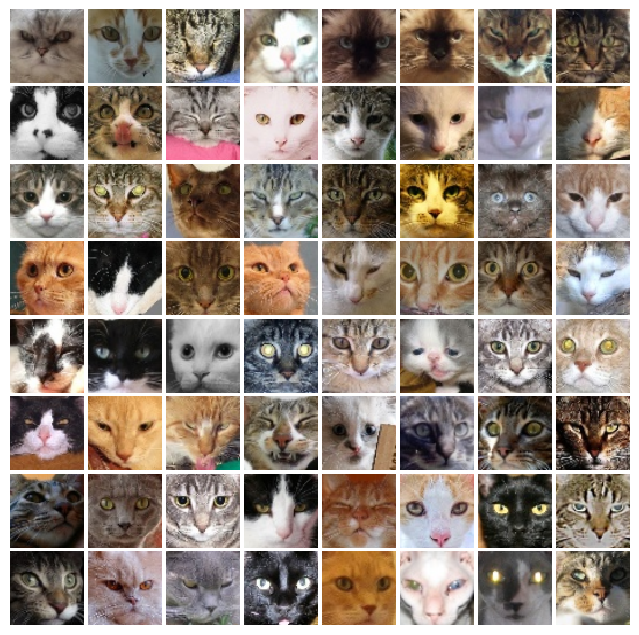

In [9]:
try:
  imgs = next(iter(cat_loader_train))[0].numpy().squeeze()
except:
  imgs = cat_loader_train.__iter__().next()[0].numpy().squeeze()

show_images(imgs, color=True)

# Обучение


# Обучение

**TODO:** Допишите недостающие строки в цикле обучения.

In [10]:
# train.py

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec


def train(
    D,
    G,
    D_solver,
    G_solver,
    discriminator_loss,
    generator_loss,
    show_every=250,
    batch_size=128,
    noise_size=100,
    num_epochs=10,
    train_loader=None,
    device=None,
):

    iter_count = 0
    for epoch in range(num_epochs):
        print("EPOCH: ", (epoch + 1))
        for x, _ in train_loader:
            _, input_channels, img_size, _ = x.shape

            real_images = preprocess_img(x).to(device)

            D_solver.zero_grad()
            
            noise = sample_noise(batch_size, noise_size).to(device)
            fake_images = G(noise)
            
            d_real = D(real_images)
            d_fake = D(fake_images.detach()) 
            
            d_error = discriminator_loss(d_real, d_fake)
            d_error.backward()
            D_solver.step()

            G_solver.zero_grad()
            
            fake_images = G(noise) 
            d_fake = D(fake_images)
            
            g_error = generator_loss(d_fake)
            g_error.backward()
            G_solver.step()

            if iter_count % show_every == 0:
                print(
                    "Iter: {}, D: {:.4}, G:{:.4}".format(
                        iter_count, d_error.item(), g_error.item()
                    )
                )
                disp_fake_images = deprocess_img(fake_images.data)
                imgs_numpy = (disp_fake_images).cpu().numpy()
                show_images(imgs_numpy[0:16], color=input_channels != 1)
                plt.show()
                print()
            iter_count += 1

### Обучение GAN

EPOCH:  1
Iter: 0, D: 1.372, G:14.85


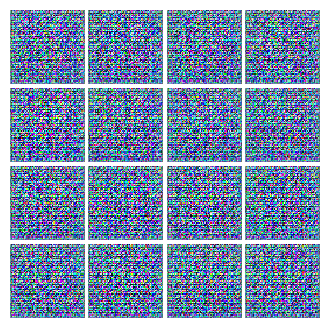


EPOCH:  2
Iter: 250, D: 1.076, G:1.799


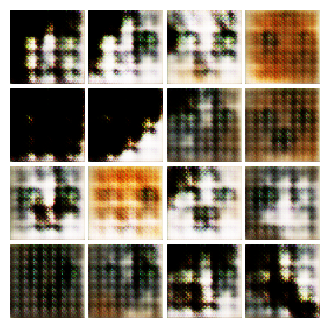


EPOCH:  3
Iter: 500, D: 1.063, G:1.541


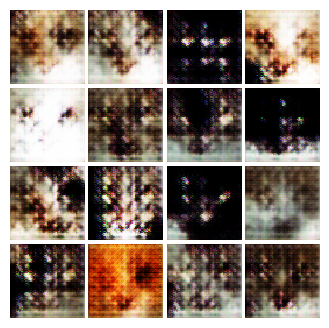


EPOCH:  4
Iter: 750, D: 1.426, G:1.508


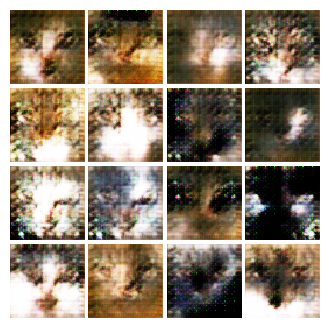


EPOCH:  5
Iter: 1000, D: 1.178, G:1.926


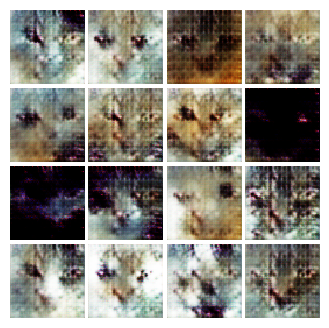


EPOCH:  6
Iter: 1250, D: 1.101, G:2.284


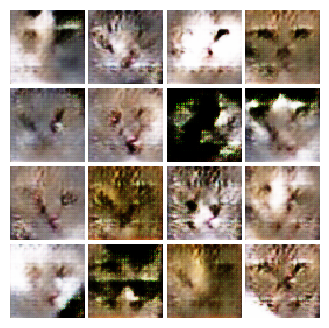


EPOCH:  7
Iter: 1500, D: 1.187, G:1.985


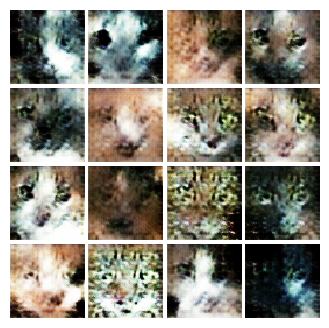


EPOCH:  8
Iter: 1750, D: 1.086, G:2.263


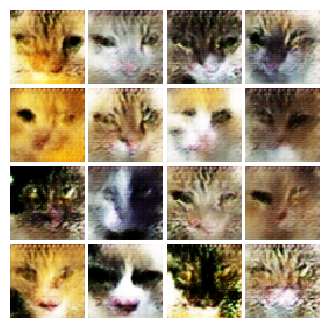


EPOCH:  9
Iter: 2000, D: 1.355, G:3.948


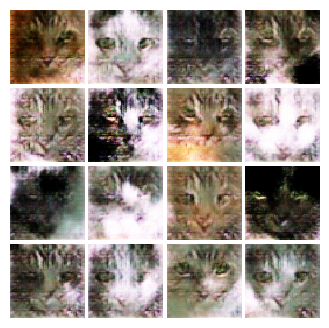


EPOCH:  10
Iter: 2250, D: 1.3, G:6.033


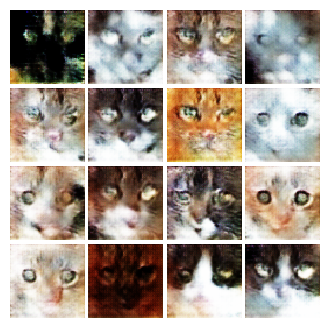


EPOCH:  11
Iter: 2500, D: 1.628, G:4.765


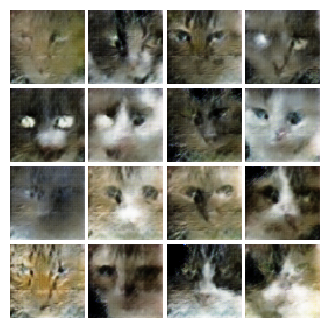


EPOCH:  12
Iter: 2750, D: 0.9879, G:4.922


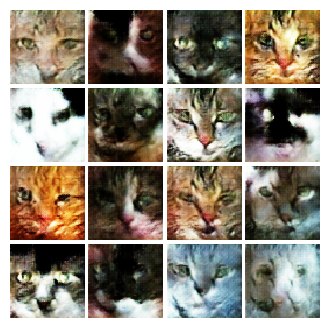


EPOCH:  13
Iter: 3000, D: 0.8903, G:2.897


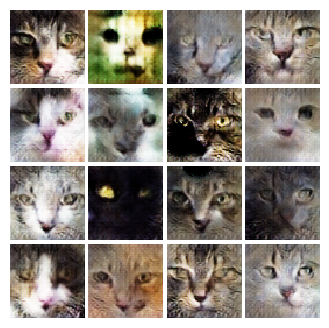


EPOCH:  14
Iter: 3250, D: 0.8209, G:2.904


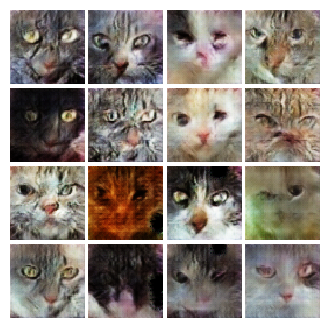


EPOCH:  15
Iter: 3500, D: 1.017, G:2.234


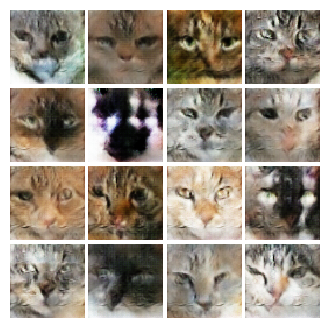


EPOCH:  16
Iter: 3750, D: 1.311, G:1.434


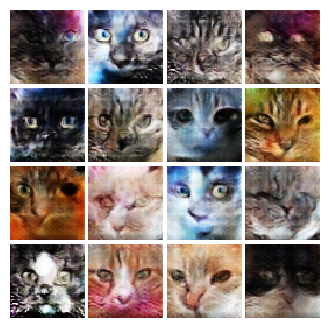


EPOCH:  17
Iter: 4000, D: 0.9437, G:2.369


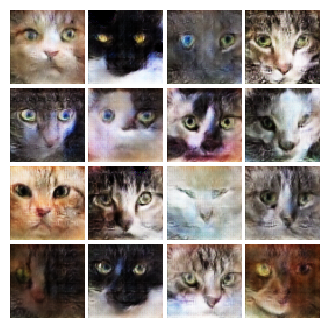


EPOCH:  18
Iter: 4250, D: 1.217, G:4.675


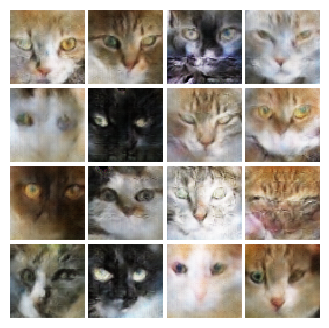


EPOCH:  19
Iter: 4500, D: 0.7612, G:3.439


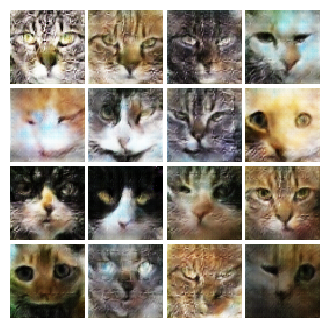


EPOCH:  20
Iter: 4750, D: 0.9884, G:3.703


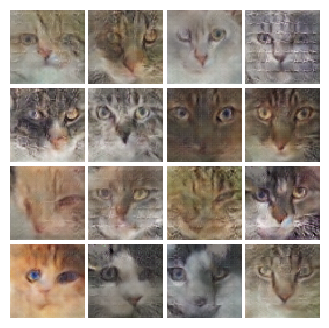


EPOCH:  21
Iter: 5000, D: 0.9286, G:3.636


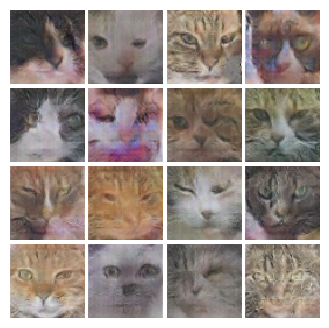


EPOCH:  22
Iter: 5250, D: 0.8853, G:3.109


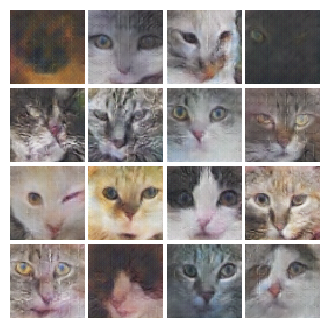


EPOCH:  23
Iter: 5500, D: 1.238, G:4.978


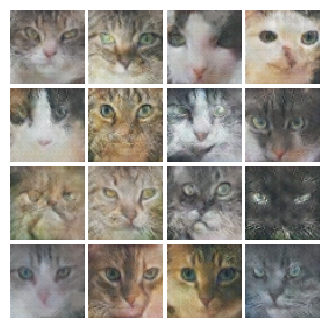


EPOCH:  24
Iter: 5750, D: 1.319, G:1.69


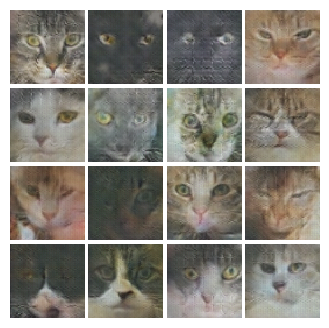


EPOCH:  25
Iter: 6000, D: 0.9306, G:3.083


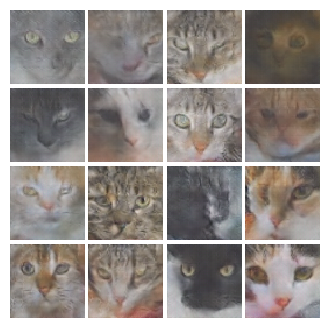


EPOCH:  26
Iter: 6250, D: 0.7537, G:3.779


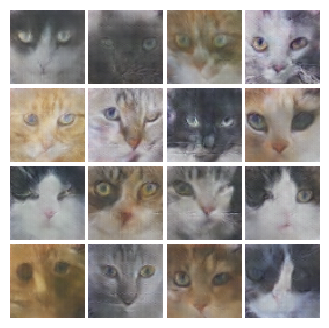


EPOCH:  27
Iter: 6500, D: 1.289, G:4.615


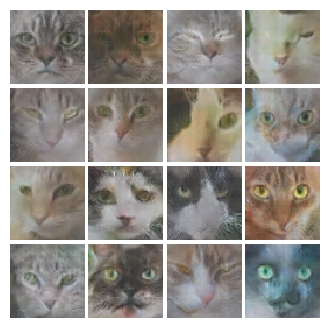


EPOCH:  28
Iter: 6750, D: 0.708, G:3.803


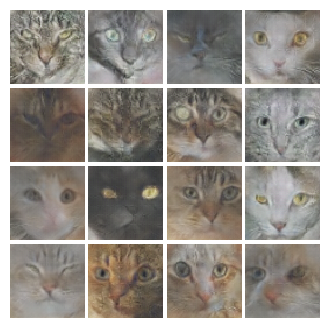


EPOCH:  29
Iter: 7000, D: 0.8055, G:3.219


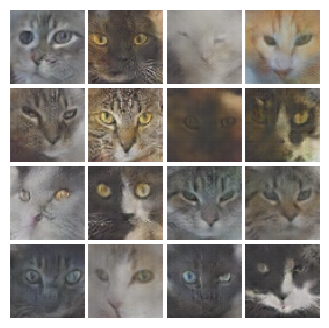


EPOCH:  30
Iter: 7250, D: 0.8741, G:2.534


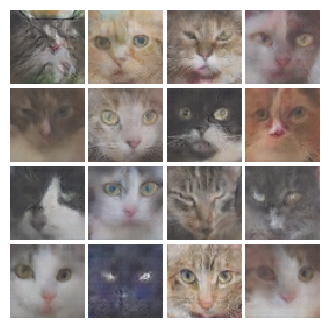


EPOCH:  31
Iter: 7500, D: 0.7025, G:3.725


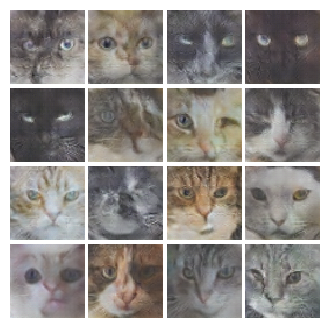


EPOCH:  32
Iter: 7750, D: 0.6772, G:4.138


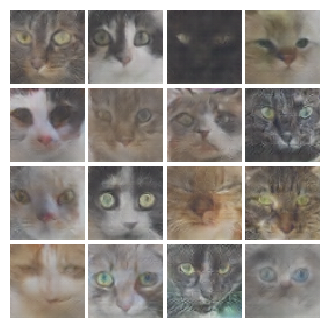


EPOCH:  33
Iter: 8000, D: 1.237, G:1.548


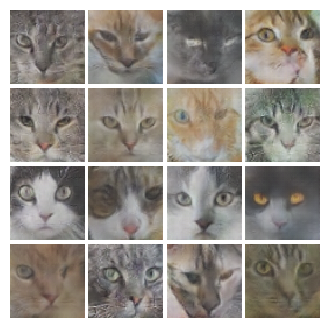


EPOCH:  34
Iter: 8250, D: 0.736, G:3.241


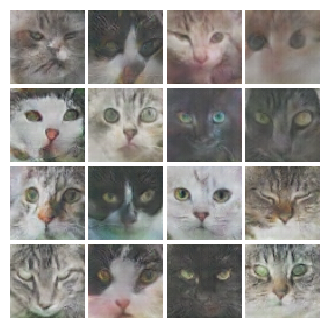


EPOCH:  35
Iter: 8500, D: 0.4969, G:3.233


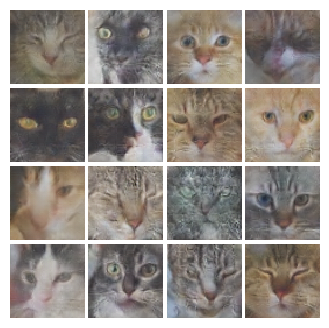


EPOCH:  36
Iter: 8750, D: 0.9373, G:2.493


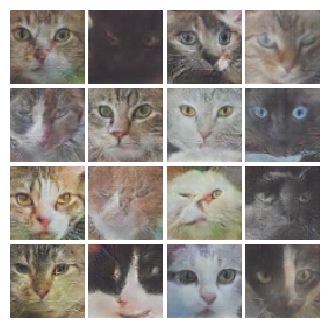


EPOCH:  37
Iter: 9000, D: 0.6615, G:2.819


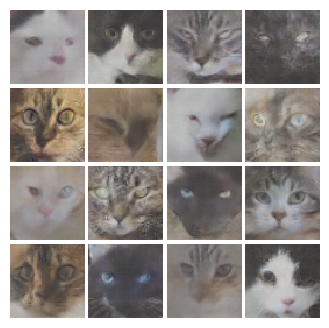


EPOCH:  38
Iter: 9250, D: 0.8861, G:6.433


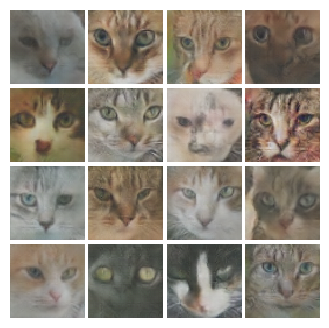


EPOCH:  39
Iter: 9500, D: 0.5424, G:5.3


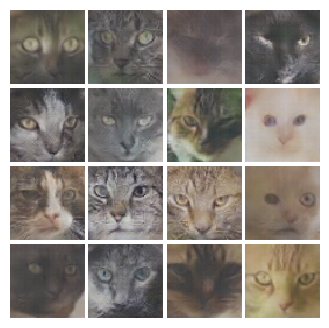


EPOCH:  40
Iter: 9750, D: 1.068, G:6.539


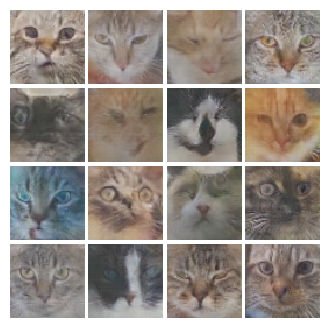


EPOCH:  41
Iter: 10000, D: 0.6625, G:4.333


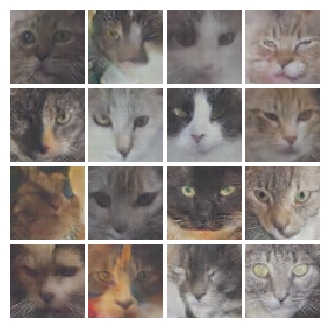


EPOCH:  42
Iter: 10250, D: 0.859, G:3.171


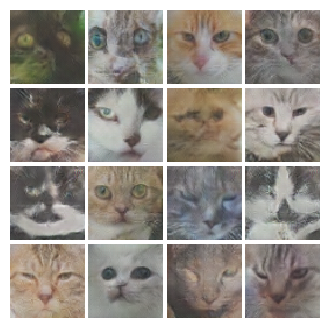


EPOCH:  43
Iter: 10500, D: 0.6777, G:2.841


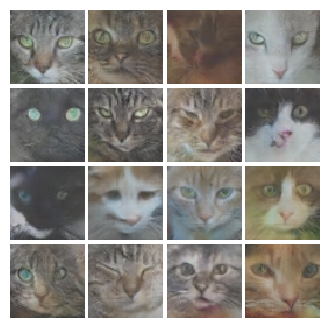


EPOCH:  44
Iter: 10750, D: 0.6105, G:2.964


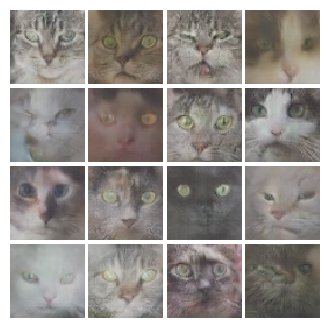


EPOCH:  45
Iter: 11000, D: 0.9884, G:6.378


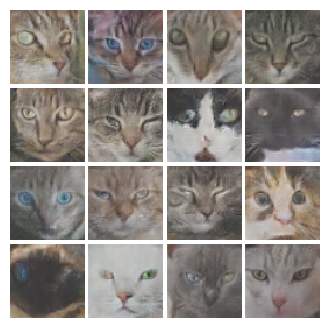


EPOCH:  46
Iter: 11250, D: 0.3236, G:4.574


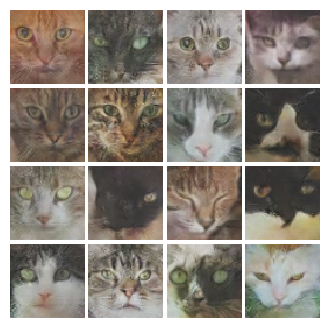


EPOCH:  47
Iter: 11500, D: 0.609, G:6.158


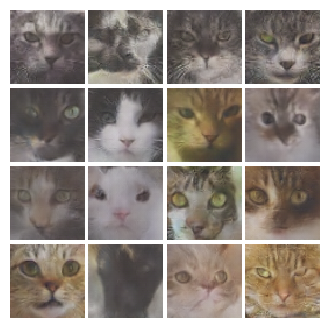


EPOCH:  48
Iter: 11750, D: 0.9598, G:2.057


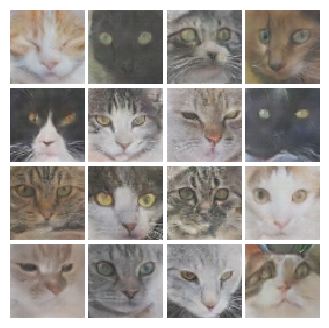


EPOCH:  49
Iter: 12000, D: 1.111, G:7.594


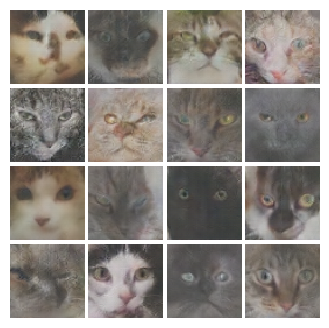


EPOCH:  50
Iter: 12250, D: 1.637, G:2.097


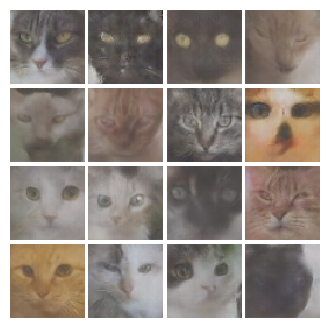

In [11]:
NOISE_DIM = 100
NUM_EPOCHS = 50
learning_rate = 0.001

D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

train(D, G, D_optimizer, G_optimizer, discriminator_loss,
          generator_loss, num_epochs=NUM_EPOCHS, show_every=250,
          batch_size=batch_size, train_loader=cat_loader_train, device=device)

### Обучение LS-GAN

EPOCH:  1
Iter: 0, D: 1.647, G:233.1


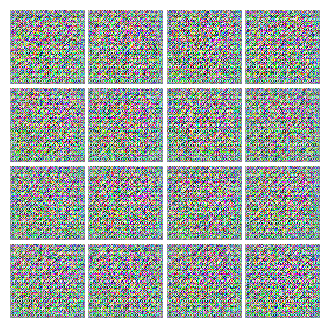


EPOCH:  2
Iter: 250, D: 0.217, G:0.7115


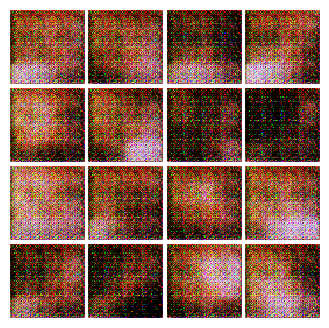


EPOCH:  3
Iter: 500, D: 0.3694, G:1.012


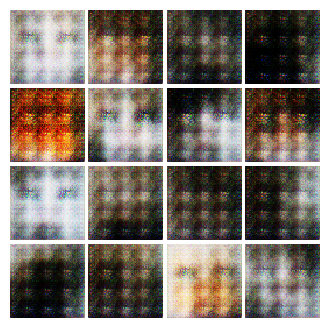


EPOCH:  4
Iter: 750, D: 0.3318, G:0.938


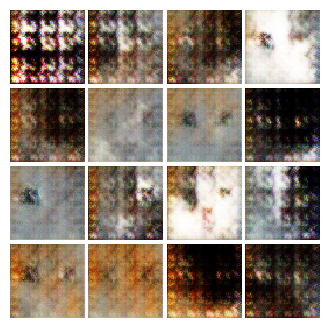


EPOCH:  5
Iter: 1000, D: 0.7434, G:1.331


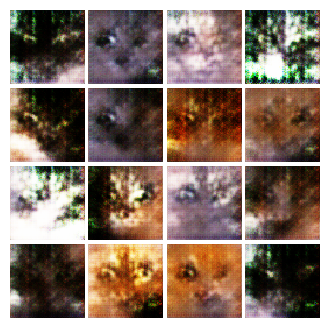


EPOCH:  6
Iter: 1250, D: 0.4163, G:0.5345


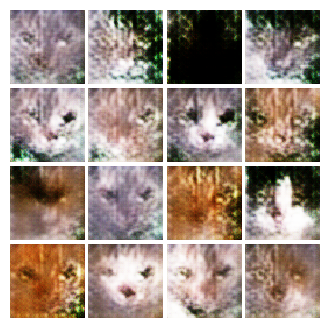


EPOCH:  7
Iter: 1500, D: 0.5723, G:1.341


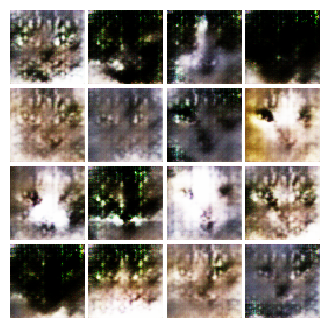


EPOCH:  8
Iter: 1750, D: 0.614, G:0.2819


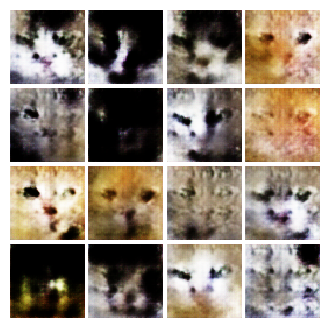


EPOCH:  9
Iter: 2000, D: 0.1675, G:0.8426


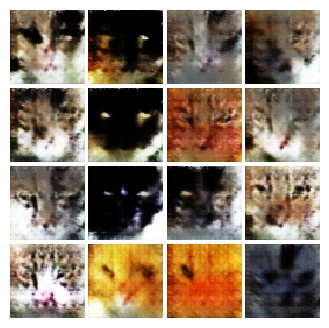


EPOCH:  10
Iter: 2250, D: 1.386, G:2.239


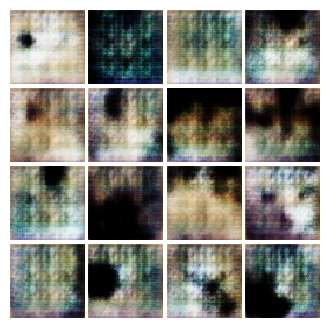


EPOCH:  11
Iter: 2500, D: 0.5096, G:1.028


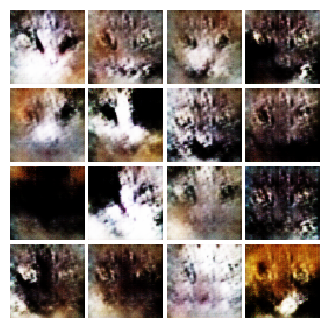


EPOCH:  12
Iter: 2750, D: 0.6426, G:1.332


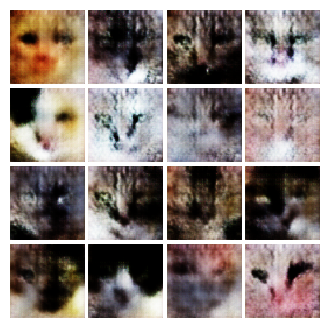


EPOCH:  13
Iter: 3000, D: 0.928, G:0.1548


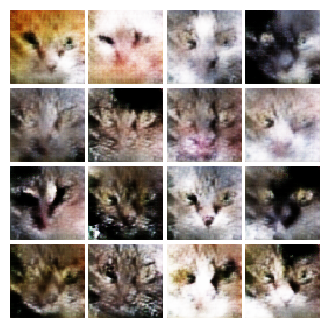


EPOCH:  14
Iter: 3250, D: 0.3835, G:1.707


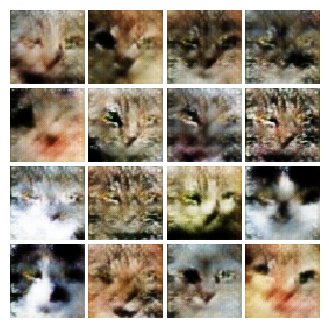


EPOCH:  15
Iter: 3500, D: 0.3136, G:0.6055


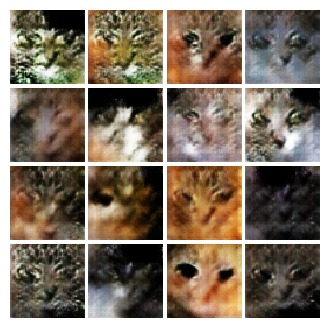


EPOCH:  16
Iter: 3750, D: 0.3376, G:0.3116


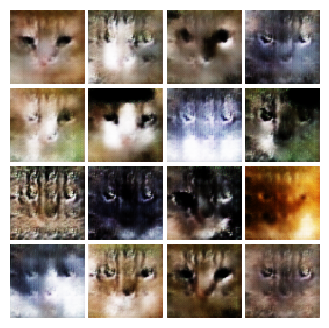


EPOCH:  17
Iter: 4000, D: 0.3258, G:1.032


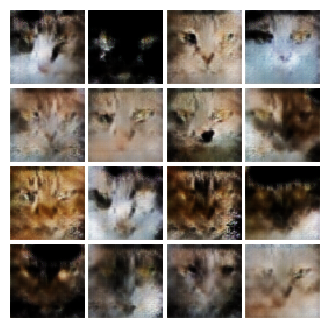


EPOCH:  18
Iter: 4250, D: 0.2463, G:1.538


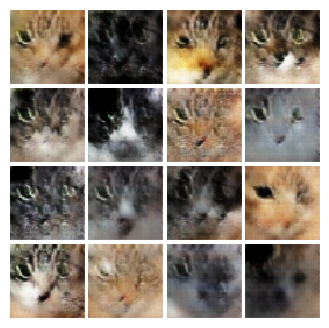


EPOCH:  19
Iter: 4500, D: 0.1313, G:1.143


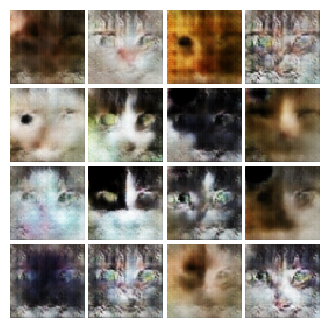


EPOCH:  20
Iter: 4750, D: 0.4169, G:1.75


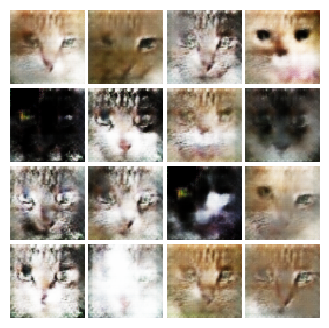


EPOCH:  21
Iter: 5000, D: 0.1768, G:0.8303


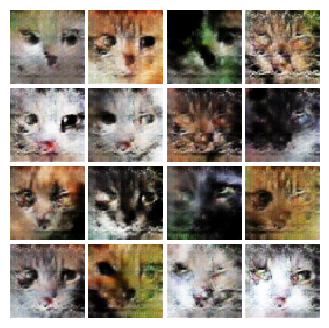


EPOCH:  22
Iter: 5250, D: 0.3165, G:1.385


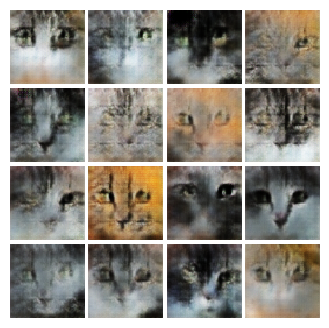


EPOCH:  23
Iter: 5500, D: 0.2898, G:2.199


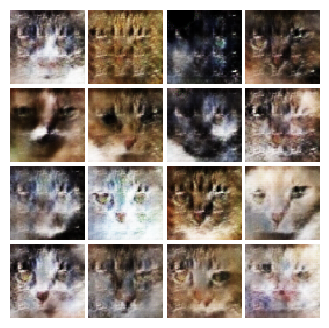


EPOCH:  24
Iter: 5750, D: 0.2171, G:1.727


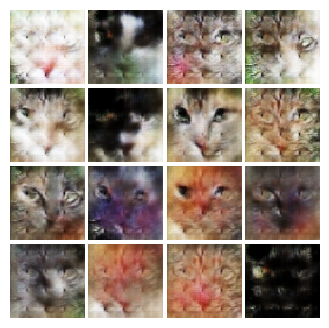


EPOCH:  25
Iter: 6000, D: 0.1644, G:1.787


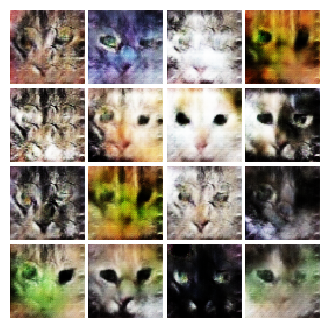


EPOCH:  26
Iter: 6250, D: 0.2501, G:0.9231


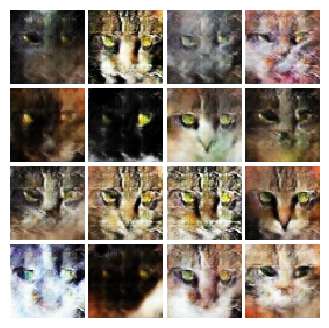


EPOCH:  27
Iter: 6500, D: 0.2104, G:0.8885


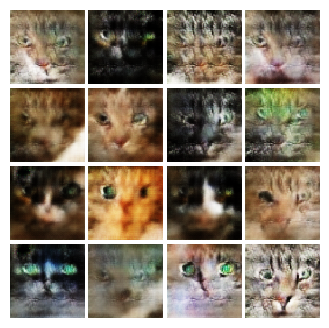


EPOCH:  28
Iter: 6750, D: 0.6629, G:0.5067


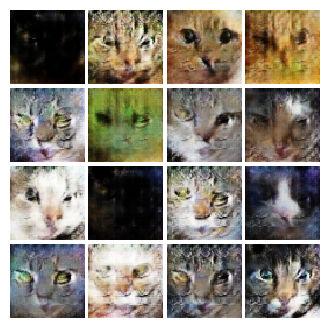


EPOCH:  29
Iter: 7000, D: 0.5303, G:2.342


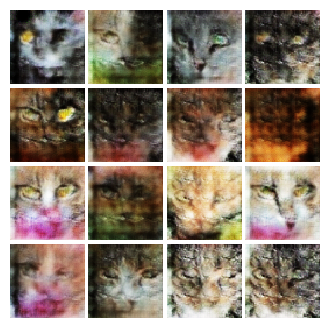


EPOCH:  30
Iter: 7250, D: 0.1744, G:1.13


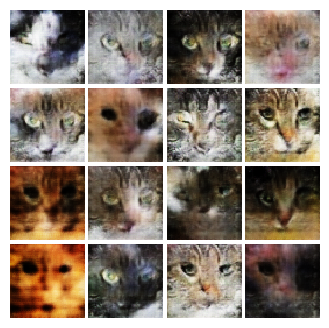


EPOCH:  31
Iter: 7500, D: 0.3102, G:0.6115


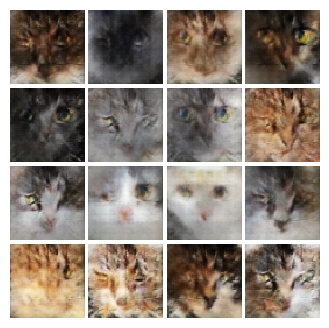


EPOCH:  32
Iter: 7750, D: 0.2832, G:1.28


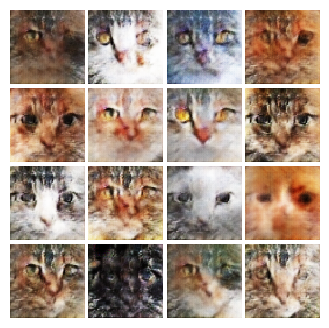


EPOCH:  33
Iter: 8000, D: 0.3538, G:1.206


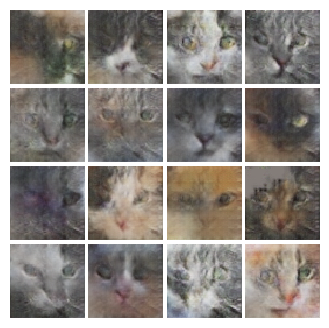


EPOCH:  34
Iter: 8250, D: 0.1257, G:0.9788


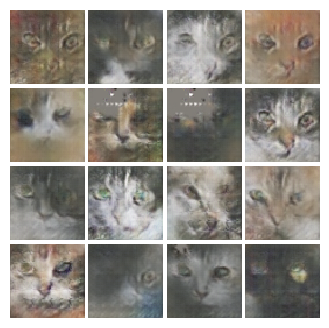


EPOCH:  35
Iter: 8500, D: 0.3522, G:0.819


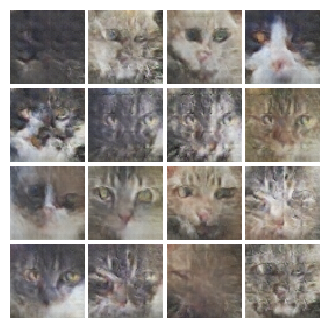


EPOCH:  36
Iter: 8750, D: 0.1893, G:0.9188


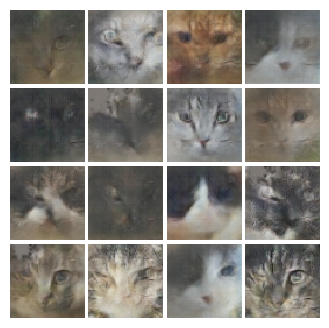


EPOCH:  37
Iter: 9000, D: 0.2257, G:1.704


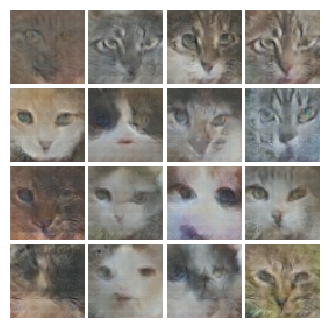


EPOCH:  38
Iter: 9250, D: 0.3551, G:1.247


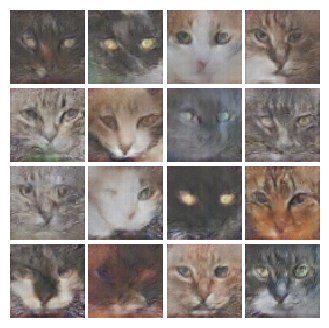


EPOCH:  39
Iter: 9500, D: 0.3187, G:1.678


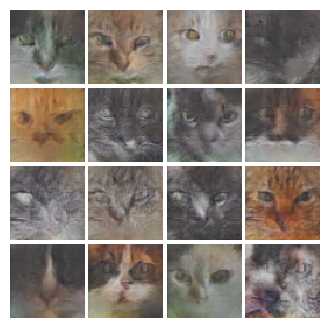


EPOCH:  40
Iter: 9750, D: 0.5116, G:0.754


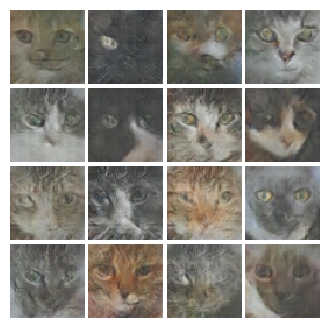


EPOCH:  41
Iter: 10000, D: 0.3415, G:0.7919


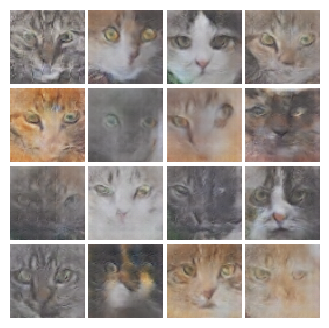


EPOCH:  42
Iter: 10250, D: 0.3848, G:1.028


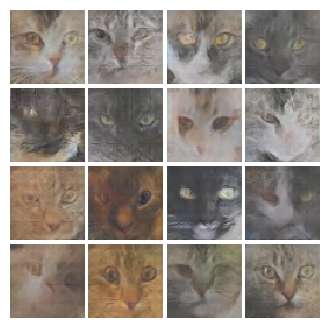


EPOCH:  43
Iter: 10500, D: 0.3624, G:0.7167


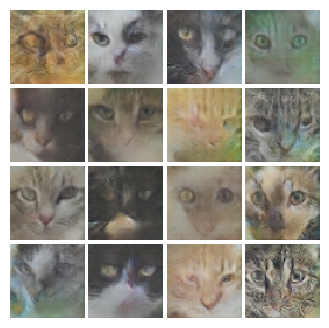


EPOCH:  44
Iter: 10750, D: 0.2056, G:0.9261


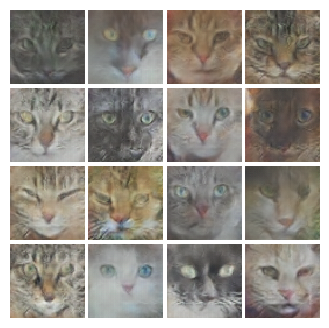


EPOCH:  45
Iter: 11000, D: 0.3753, G:0.9876


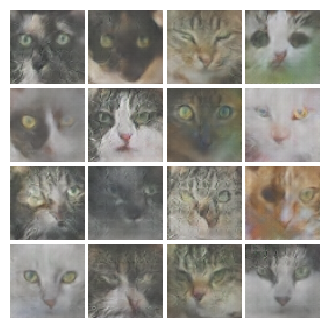


EPOCH:  46
Iter: 11250, D: 0.2784, G:0.9655


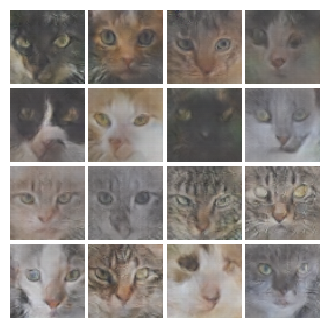


EPOCH:  47
Iter: 11500, D: 0.2874, G:0.7892


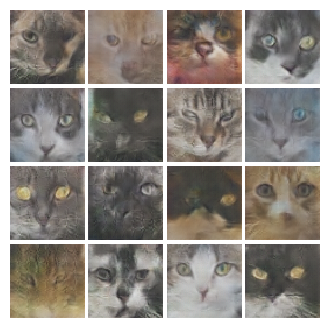


EPOCH:  48
Iter: 11750, D: 0.3767, G:0.6784


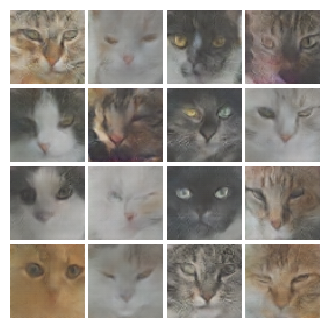


EPOCH:  49
Iter: 12000, D: 0.2961, G:1.019


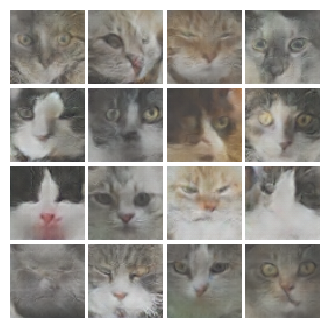


EPOCH:  50
Iter: 12250, D: 0.4256, G:0.968


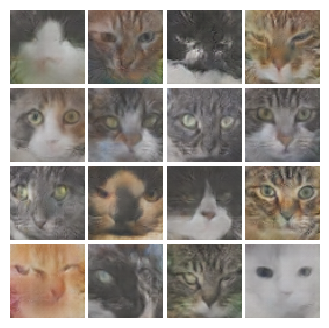

In [12]:
NOISE_DIM = 100
NUM_EPOCHS = 50
learning_rate = 0.0005

D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

train(D, G, D_optimizer, G_optimizer, ls_discriminator_loss,
          ls_generator_loss, num_epochs=NUM_EPOCHS, show_every=250,
          batch_size=batch_size, train_loader=cat_loader_train, device=device)

# MedMnist

In [13]:
!pip install medmnist

clear_output()

In [14]:
import torch.utils.data as data
import torchvision.transforms as transforms

from torch.utils.data import Subset
from medmnist import BloodMNIST

batch_size = 64
imsize = 64

# preprocessing
data_transform = transforms.Compose([
    transforms.ToTensor(),
])

blood_dataset = BloodMNIST(split="train", download=True, size=imsize, transform=data_transform)

100%|██████████| 156M/156M [00:02<00:00, 75.4MB/s]


In [15]:
# Выберите класс, который хотите фильтровать
class_to_filter = 1

# Собираем индексы примеров, относящихся к данному классу
indices = [i for i, (_, label) in enumerate(blood_dataset) if label == class_to_filter]

# Создаем новый поднабор данных из отфильтрованных индексов
filtered_dataset = Subset(blood_dataset, indices)

train_loader = data.DataLoader(dataset=filtered_dataset, batch_size=batch_size, shuffle=True)

In [16]:
import numpy as np

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec


def show_images(images, color=False):
    if color:
        sqrtimg = int(np.ceil(np.sqrt(images.shape[2] * images.shape[3])))
    else:
        images = np.reshape(
            images, [images.shape[0], -1]
        )  # images reshape to (batch_size, D)
        sqrtimg = int(np.ceil(np.sqrt(images.shape[1])))
    sqrtn = int(np.ceil(np.sqrt(images.shape[0])))

    fig = plt.figure(figsize=(sqrtn, sqrtn))
    gs = gridspec.GridSpec(sqrtn, sqrtn)
    gs.update(wspace=0.05, hspace=0.05)

    for i, img in enumerate(images):
        ax = plt.subplot(gs[i])
        plt.axis("off")
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_aspect("equal")
        if color:
            plt.imshow(np.swapaxes(np.swapaxes(img, 0, 1), 1, 2))
        else:
            plt.imshow(img.reshape([sqrtimg, sqrtimg]))
    return

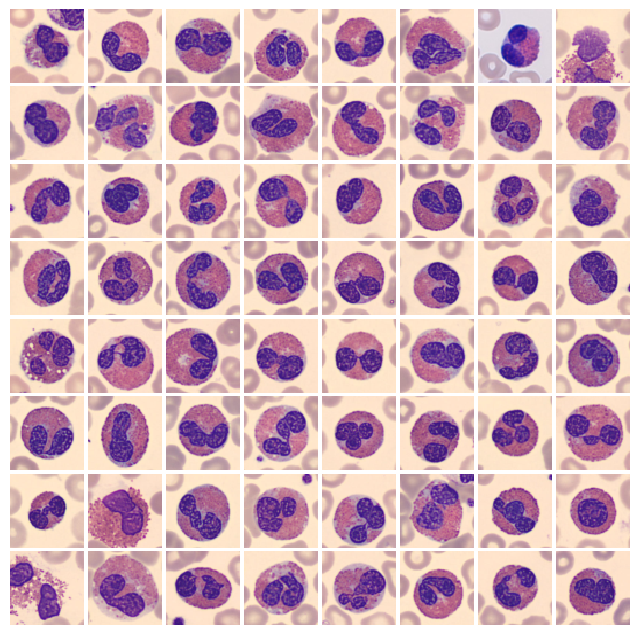

In [17]:
imgs = next(iter(train_loader))[0].numpy().squeeze()

show_images(imgs, color=True)

EPOCH:  1
Iter: 0, D: 1.228, G:15.79


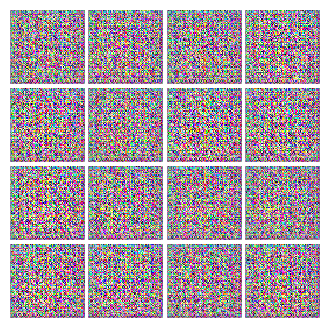


EPOCH:  2
EPOCH:  3
EPOCH:  4
EPOCH:  5
EPOCH:  6
EPOCH:  7
EPOCH:  8
Iter: 250, D: 0.0198, G:5.291


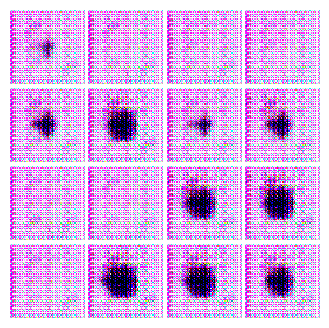


EPOCH:  9
EPOCH:  10
EPOCH:  11
EPOCH:  12
EPOCH:  13
EPOCH:  14
EPOCH:  15
Iter: 500, D: 0.6105, G:1.87


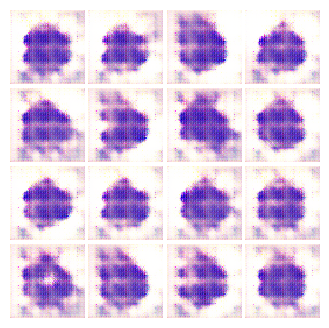


EPOCH:  16
EPOCH:  17
EPOCH:  18
EPOCH:  19
EPOCH:  20
EPOCH:  21
EPOCH:  22
Iter: 750, D: 0.001029, G:7.493


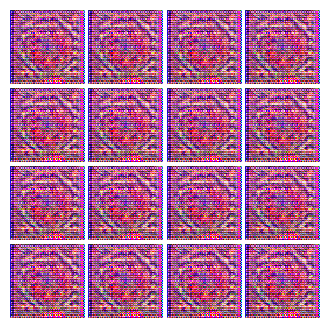


EPOCH:  23
EPOCH:  24
EPOCH:  25
EPOCH:  26
EPOCH:  27
EPOCH:  28
EPOCH:  29
Iter: 1000, D: 0.001131, G:7.777


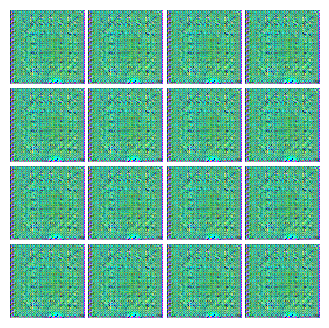


EPOCH:  30
EPOCH:  31
EPOCH:  32
EPOCH:  33
EPOCH:  34
EPOCH:  35
EPOCH:  36
Iter: 1250, D: 1.796, G:8.419


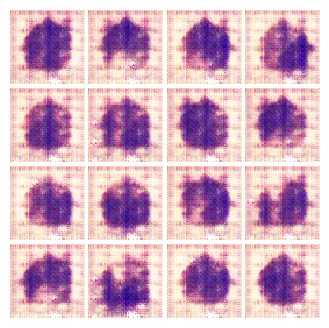


EPOCH:  37
EPOCH:  38
EPOCH:  39
EPOCH:  40
EPOCH:  41
EPOCH:  42
EPOCH:  43
Iter: 1500, D: 0.7333, G:1.383


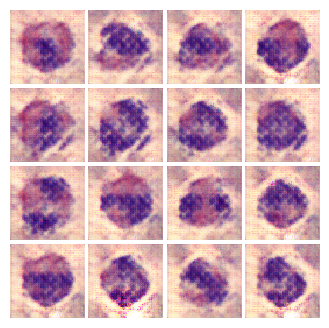


EPOCH:  44
EPOCH:  45
EPOCH:  46
EPOCH:  47
EPOCH:  48
EPOCH:  49
EPOCH:  50


In [18]:
NOISE_DIM = 100
NUM_EPOCHS = 50
learning_rate = 0.001

D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

train(D, G, D_optimizer, G_optimizer, discriminator_loss,
          generator_loss, num_epochs=NUM_EPOCHS, show_every=250,
          batch_size=batch_size, train_loader=train_loader, device=device)

EPOCH:  1
Iter: 0, D: 0.6614, G:82.61


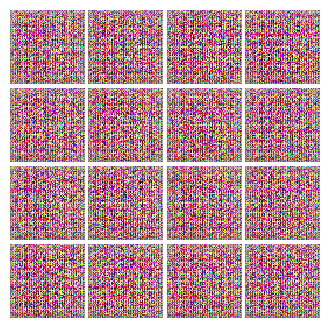


EPOCH:  2
EPOCH:  3
EPOCH:  4
EPOCH:  5
EPOCH:  6
EPOCH:  7
EPOCH:  8
Iter: 250, D: 0.2225, G:0.3123


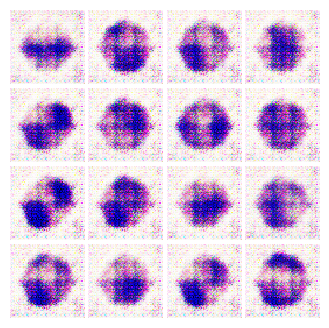


EPOCH:  9
EPOCH:  10
EPOCH:  11
EPOCH:  12
EPOCH:  13
EPOCH:  14
EPOCH:  15
Iter: 500, D: 0.00644, G:1.023


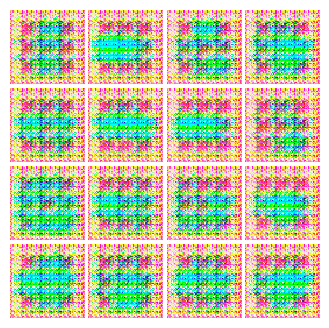


EPOCH:  16
EPOCH:  17
EPOCH:  18
EPOCH:  19
EPOCH:  20
EPOCH:  21
EPOCH:  22
Iter: 750, D: 0.9439, G:2.844


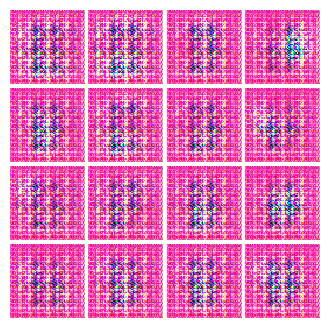


EPOCH:  23
EPOCH:  24
EPOCH:  25
EPOCH:  26
EPOCH:  27
EPOCH:  28
EPOCH:  29
Iter: 1000, D: 2.741, G:64.01


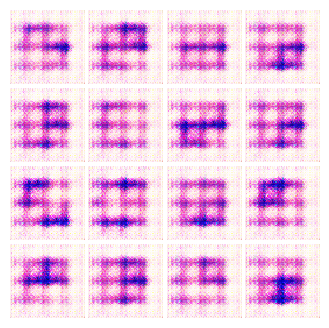


EPOCH:  30
EPOCH:  31
EPOCH:  32
EPOCH:  33
EPOCH:  34
EPOCH:  35
EPOCH:  36
Iter: 1250, D: 0.3079, G:0.3926


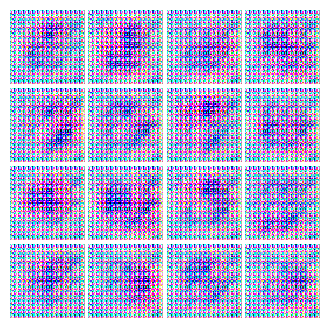


EPOCH:  37
EPOCH:  38
EPOCH:  39
EPOCH:  40
EPOCH:  41
EPOCH:  42
EPOCH:  43
Iter: 1500, D: 2.159, G:0.02376


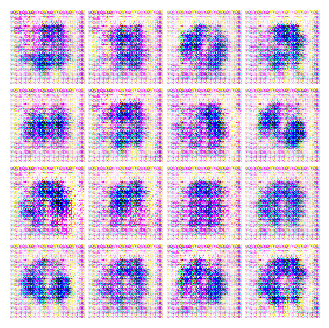


EPOCH:  44
EPOCH:  45
EPOCH:  46
EPOCH:  47
EPOCH:  48
EPOCH:  49
EPOCH:  50


In [19]:
NOISE_DIM = 100
NUM_EPOCHS = 50
learning_rate = 0.0005

D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

train(D, G, D_optimizer, G_optimizer, ls_discriminator_loss,
          ls_generator_loss, num_epochs=NUM_EPOCHS, show_every=250,
          batch_size=batch_size, train_loader=train_loader, device=device)

### В результате работы 1 и 2 обучили генеративную модель. Теперь мы можем генерировать котят и клетки. Соответсвенно на клетки нужно было использовать больше эпох, поскольку изображения получились достаточно неточно сгенерированы, по ним сложно понять, что это именно клетки. Котята получились хорошо. Также видим небольшой дисбаланс генератора и дискриминатора, чтобы это улучшить можно использовать Wassertain GAN